<a href="https://colab.research.google.com/github/elabrodsky/portfolio/blob/main/Heart_Disease_Data_Analysis_Python_and_plotly_Tulane_MBA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Key Indicators of Heart Disease (2020 annual CDC survey data of 400k adults related to their health status)**

data:https://www.kaggle.com/datasets/kamilpytlak/personal-key-indicators-of-heart-disease

Data size: approximately 400 thousand adults in the US, features:

**HeartDisease:** Respondents that have ever reported having coronary heart disease (CHD) or myocardial infarction (MI)

**BMI:** Body Mass Index (BMI)

**Smoking:** Have you smoked at least 100 cigarettes in your entire life? [Note: 5 packs = 100 cigarettes]

**AlcoholDrinking:** Heavy drinkers (adult men having more than 14 drinks per week and adult women having more than 7 drinks per week

**Stroke:** (Ever told) (you had) a stroke?

**PhysicalHealth:** Now thinking about your physical health, which includes physical illness and injury, for how many days during the past 30 days was your physical health not good? (0-30 days)

**MentalHealth:** Thinking about your mental health, for how many days during the past 30 days was your mental health not good? (0-30 days)

**DiffWalking:** Do you have serious difficulty walking or climbing stairs?
**Sex:** Are you male or female?

**AgeCategory:** Fourteen-level age category



Import data and preview

In [ ]:
import numpy as np 
#import matplotlib.pyplot as plt 
import pandas as pd 

datalink = 'https://raw.githubusercontent.com/elabrodsky/tulanemba/main/heart_2020_cleaned.csv'

df = pd.read_table(datalink,sep=',',header=(0)) 
df.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,No,16.60,Yes,No,No,3.0,30.0,No,Female,55-59,White,Yes,Yes,Very good,5.0,Yes,No,Yes
1,No,20.34,No,No,Yes,0.0,0.0,No,Female,80 or older,White,No,Yes,Very good,7.0,No,No,No
2,No,26.58,Yes,No,No,20.0,30.0,No,Male,65-69,White,Yes,Yes,Fair,8.0,Yes,No,No
3,No,24.21,No,No,No,0.0,0.0,No,Female,75-79,White,No,No,Good,6.0,No,No,Yes
4,No,23.71,No,No,No,28.0,0.0,Yes,Female,40-44,White,No,Yes,Very good,8.0,No,No,No


In [ ]:
df.describe()[1:][['BMI','PhysicalHealth','MentalHealth', 'SleepTime']].T.style.background_gradient(cmap='Blues')

,mean,std,min,25%,50%,75%,max
BMI,28.325399,6.356100,12.020000,24.030000,27.340000,31.420000,94.850000
PhysicalHealth,3.371710,7.950850,0.000000,0.000000,0.000000,2.000000,30.000000
MentalHealth,3.898366,7.955235,0.000000,0.000000,0.000000,3.000000,30.000000
SleepTime,7.097075,1.436007,1.000000,6.000000,7.000000,8.000000,24.000000


convert string data to numeric for all columns

In [ ]:
#convert data to numeric

from sklearn import preprocessing

df_num = df

encode_AgeCategory = {'55-59':57, '80 or older':80, '65-69':67,
                      '75-79':77,'40-44':42,'70-74':72,'60-64':62,
                      '50-54':52,'45-49':47,'18-24':21,'35-39':37,
                      '30-34':32,'25-29':27}
df_num['AgeCategory'] = df_num['AgeCategory'].apply(lambda x: encode_AgeCategory[x])
df_num['AgeCategory'] = df_num['AgeCategory'].astype('float')

# Integer encode columns with 2 unique values
for col in ['Smoking', 'AlcoholDrinking', 'Stroke', 'DiffWalking', 'Sex', 'PhysicalActivity', 'Asthma', 'KidneyDisease', 'SkinCancer']:
    if df[col].dtype == 'O':
        le = preprocessing.LabelEncoder()
        df_num[col] = le.fit_transform(df[col])

# One-hot encode columns with more than 2 unique values
df_num = pd.get_dummies(df, columns=['Race', 'Diabetic', 'GenHealth', ], prefix = ['Race', 'Diabetic', 'GenHealth'])
df_num.head()

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,...,Race_White,Diabetic_No,"Diabetic_No, borderline diabetes",Diabetic_Yes,Diabetic_Yes (during pregnancy),GenHealth_Excellent,GenHealth_Fair,GenHealth_Good,GenHealth_Poor,GenHealth_Very good
0,No,16.60,1,0,0,3.0,30.0,0,0,57.0,...,1,0,0,1,0,0,0,0,0,1
1,No,20.34,0,0,1,0.0,0.0,0,0,80.0,...,1,1,0,0,0,0,0,0,0,1
2,No,26.58,1,0,0,20.0,30.0,0,1,67.0,...,1,0,0,1,0,0,1,0,0,0
3,No,24.21,0,0,0,0.0,0.0,0,0,77.0,...,1,1,0,0,0,0,0,1,0,0
4,No,23.71,0,0,0,28.0,0.0,1,0,42.0,...,1,1,0,0,0,0,0,0,0,1


In [ ]:
#install plotly dash
!pip install dash -q

In [ ]:
import plotly.graph_objects as go

plotwidth=700

#BMI
figBMI = go.Figure()
figBMI.add_trace(go.Histogram(x=df_num[df_num['HeartDisease']=='Yes']['BMI'],
              name='Heart Disease = Yes', marker_color='blue'))
figBMI.add_trace(go.Histogram(x=df_num[df_num['HeartDisease']=='No']['BMI'],
              name='Heart Disease = No', marker_color='red'))

figBMI.update_layout(barmode='overlay',
                     title_text="BMI",
                     width=plotwidth,
                     template="plotly_white")
figBMI.update_traces(opacity=0.5)
figBMI.update_layout()

#SleepTime
figSleep = go.Figure()
figSleep.add_trace(go.Histogram(x=df_num[df_num['HeartDisease']=='Yes']['SleepTime'],
              name='Heart Disease = Yes', marker_color='blue'))
figSleep.add_trace(go.Histogram(x=df_num[df_num['HeartDisease']=='No']['SleepTime'],
              name='Heart Disease = No', marker_color='red'))

figSleep.update_layout(barmode='overlay',
                       title_text="SleepTime",
                       width=plotwidth,
                       template="plotly_white")
figSleep.update_traces(opacity=0.5)

#PhysicalHealth
figPH = go.Figure()
figPH.add_trace(go.Histogram(x=df_num[df_num['HeartDisease']=='Yes']['PhysicalHealth'],
              name='Heart Disease = Yes', marker_color='blue'))
figPH.add_trace(go.Histogram(x=df_num[df_num['HeartDisease']=='No']['PhysicalHealth'],
              name='Heart Disease = No', marker_color='red'))

figPH.update_layout(barmode='overlay',
                    title_text="PhysicalHealth",
                    width=plotwidth,
                    template="plotly_white")
figPH.update_traces(opacity=0.5)

#MentalHealth
figMH = go.Figure()
figMH.add_trace(go.Histogram(x=df_num[df_num['HeartDisease']=='Yes']['MentalHealth'],
              name='Heart Disease = Yes', marker_color='blue'))
figMH.add_trace(go.Histogram(x=df_num[df_num['HeartDisease']=='No']['MentalHealth'],
              name='Heart Disease = No', marker_color='red'))

figMH.update_layout(barmode='overlay',
                    title_text="MentalHealth",
                    width=plotwidth,
                    template="plotly_white")
figMH.update_traces(opacity=0.5)


figBMI.show()
figSleep.show()
figPH.show()
figMH.show()

In [ ]:
import plotly.express as px

fig = px.imshow(df_num[['HeartDisease', 'Smoking', 'AlcoholDrinking', 'Stroke', 'DiffWalking', 'Sex',
                    'PhysicalActivity', 'Asthma', 'KidneyDisease', 'SkinCancer','BMI', 'PhysicalHealth',
                    'MentalHealth', 'AgeCategory', 'SleepTime']].corr(),color_continuous_scale="Reds")
fig.update_layout(height=800)
fig.show()

Perform PCA for visual exploration of all data

In [ ]:
from sklearn.preprocessing import StandardScaler 
from sklearn.decomposition import PCA 

df_num1 = df_num
df_num1['HeartDisease'] = df_num1['HeartDisease'].map(dict(Yes=1, No=0))

scaled = StandardScaler() 
scaled.fit(df_num1) 
scaled_data = scaled.transform(df_num1) 

#Run Principal Component Analysis
pca = PCA(n_components=3) 
pca.fit(scaled_data) 
xpca = pca.transform(scaled_data)

PC1_label = "PC1 {}%".format(round(pca.explained_variance_ratio_[0],2)*100)
PC2_label = "PC2 {}%".format(round(pca.explained_variance_ratio_[1],2)*100) 
PC3_label = "PC3 {}%".format(round(pca.explained_variance_ratio_[2],2)*100)

#create dataframe for PCA
df_pca = pd.DataFrame(xpca)
df_pca.columns = [PC1_label,PC2_label,PC3_label]

#visualize
figPCA = px.scatter_3d(df_pca, x=PC1_label, y=PC2_label, z=PC3_label, 
                       title="PCA 3D plot", color=df_num.HeartDisease, 
                       template="plotly_white", height=800)
figPCA.show()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:985: RuntimeWarning:

invalid value encountered in true_divide

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:990: RuntimeWarning:

invalid value encountered in true_divide

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:1020: RuntimeWarning:

invalid value encountered in true_divide



ValueError: ignored

In [ ]:
pca.explained_variance_ratio_[0]

AttributeError: ignored

Clustering - what number of clusters is optimal for the dataset.

approaches: inertia (Within-clusters Sum of Squared errors) and silhouette (The silhouette coefficient is a measure of how similar a data point is within-cluster (cohesion) compared to other clusters (separation))  average score

In [ ]:
# import SciKit clustering methods: K-means
from sklearn.cluster import KMeans

#create a dataframe for k-means inertia
inertia = pd.DataFrame()

#record inertia for k=1-10 using k-means clustering
for i in range (1,15):
  kmeans_m = KMeans(n_clusters=i).fit(df_num1)
  inertia = inertia.append({'clust':i,'inertia': kmeans_m.inertia_}, 
                            ignore_index=True)

#plot k-means inertia elbow plot
figInertia = px.line(inertia, x="clust", y="inertia",
                     title="Elbow Plot for K-means Inertia (Within-clusters Sum of Squared errors)", 
                     template="plotly_white", 
                     height=800, markers=True)
figInertia.update_layout(
    xaxis_title="number of clusters",
    yaxis_title="inertia / SSE (within-clusters sum of squared errors)",
)

figInertia.show()

In [ ]:
#run k-means with n clusters
kmeans_m = KMeans(n_clusters=4).fit(df_num1)

kmeans_m.labels_ = kmeans_m.labels_.astype(str)

#visualize output using PCA
figPCA = px.scatter_3d(df_pca, x=PC1_label, y=PC2_label, z=PC3_label, 
                       title="PCA 3D plot", color=kmeans_m.labels_, 
                       template="plotly_white", height=800)
figPCA.show()

In [ ]:
from sklearn.cluster import DBSCAN

dbscan_m = DBSCAN(eps=0.7, min_samples=30).fit(scaled_data)
dbscan_m.labels_


array([-1, -1, -1, ..., 62, -1, -1])

In [ ]:
#rerun 
df_num2 = df_num1[[ 'BMI', 'PhysicalHealth',
                    'MentalHealth', 'AgeCategory', 'SleepTime']]

scaled = StandardScaler() 
scaled.fit(df_num2) 
scaled_data = scaled.transform(df_num2) 

#Run Principal Component Analysis
pca = PCA(n_components=3) 
pca.fit(scaled_data) 
xpca = pca.transform(scaled_data)

PC1_label = "PC1 {}%".format(round(pca.explained_variance_ratio_[0],2)*100)
PC2_label = "PC2 {}%".format(round(pca.explained_variance_ratio_[1],2)*100) 
PC3_label = "PC3 {}%".format(round(pca.explained_variance_ratio_[2],2)*100)

#create dataframe for PCA
df_pca = pd.DataFrame(xpca)
df_pca.columns = [PC1_label,PC2_label,PC3_label]

#visualize
figPCA = px.scatter_3d(df_pca, x=PC1_label, y=PC2_label, z=PC3_label, 
                       title="PCA 3D plot", color=df_num.HeartDisease, 
                       template="plotly_white", height=800)
figPCA.show()



In [ ]:
import itertools

df_num2['Kmeans'] = kmeans_m.labels_
df_num2.head()
cluster_num = []

i=0
cluster_num = df_num2.groupby('Kmeans')["Kmeans"].count()

#visualize output using PCA
figPCA = px.bar(cluster_num, 
                title="Number of Items in Kmeans Clusters (n=4)", 
                text=cluster_num,
                template="plotly_white")
figPCA.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
cluster_num

Kmeans
0    126188
1     77574
2     26917
3     89116
Name: Kmeans, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

X = df_num1.iloc[:, 1:].values
y = df_num1.iloc[:, 0].values

classes = np.unique(y)
n_classes = len(classes)

features = np.unique(df_num1.columns)
features1 = np.delete(features,15)
features1

array(['AgeCategory', 'AlcoholDrinking', 'Asthma', 'BMI', 'Diabetic_No',
       'Diabetic_No, borderline diabetes', 'Diabetic_Yes',
       'Diabetic_Yes (during pregnancy)', 'DiffWalking',
       'GenHealth_Excellent', 'GenHealth_Fair', 'GenHealth_Good',
       'GenHealth_Poor', 'GenHealth_Very good', 'HeartDisease',
       'MentalHealth', 'PhysicalActivity', 'PhysicalHealth',
       'Race_American Indian/Alaskan Native', 'Race_Asian', 'Race_Black',
       'Race_Hispanic', 'Race_Other', 'Race_White', 'Sex', 'SkinCancer',
       'SleepTime', 'Smoking', 'Stroke'], dtype=object)

In [ ]:
#split to train and test
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=0)

Run Random Forest on all features

In [ ]:

#define Random forest model
model = RandomForestClassifier(n_estimators=500, bootstrap=True, verbose=True, max_leaf_nodes=10)

#fit model on training data
model.fit(X_train, y_train)
estimator = model.estimators_[10]

#Predict test data
predictions = model.predict(X_test)


print(confusion_matrix(y_test,predictions, labels=classes))

conf = confusion_matrix(y_test,predictions)
new_conf = pd.DataFrame(conf, columns=classes, index=classes)

print(classification_report(y_test,predictions, zero_division=0))
print(accuracy_score(y_test, predictions))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:   53.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:    3.1s finished


[[87730     0]
 [ 8209     0]]
              precision    recall  f1-score   support

           0       0.91      1.00      0.96     87730
           1       0.00      0.00      0.00      8209

    accuracy                           0.91     95939
   macro avg       0.46      0.50      0.48     95939
weighted avg       0.84      0.91      0.87     95939

0.914435214042256


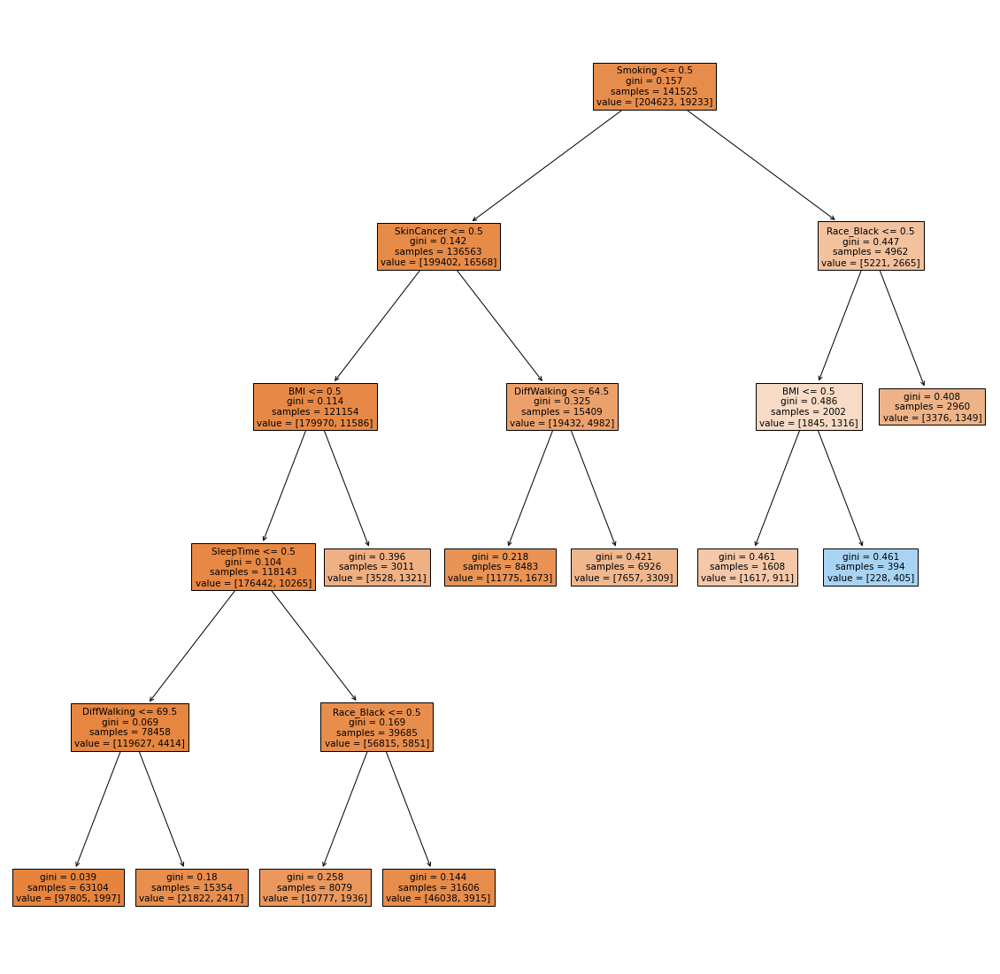

In [ ]:
import matplotlib.pyplot as plt 
from sklearn import tree

plt.figure(figsize=(20,20))
_ = tree.plot_tree(model.estimators_[0], feature_names=features1, filled=True)

In [ ]:
importances = model.feature_importances_
std = np.std([tree.feature_importances_ for tree in model.estimators_], axis=0)
forest_importances = pd.Series(importances, index=features1)

figImportance = px.bar(forest_importances, title="Feature Significance", 
                     template="plotly_white", height=800).update_xaxes(categoryorder="total descending")


figImportance.show()


ValueError: ignored

In [ ]:
df_num3 = df_num[['HeartDisease', 'BMI', 'PhysicalHealth',
                    'MentalHealth', 'AgeCategory', 'SleepTime', 'Smoking', 'DiffWalking']]
df_num3['HeartDisease'] = df_num3['HeartDisease'].map(dict(Yes=1, No=0))
df_num3['Smoking'] = df_num3['Smoking'].map(dict(Yes=1, No=0))
df_num3['DiffWalking'] = df_num3['DiffWalking'].map(dict(Yes=1, No=0))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

In [ ]:
df_num3 = df_num2.iloc[:,0:5]
df_num3

,BMI,PhysicalHealth,MentalHealth,AgeCategory,SleepTime
0,16.60,3.0,30.0,57.0,5.0
1,20.34,0.0,0.0,80.0,7.0
2,26.58,20.0,30.0,67.0,8.0
3,24.21,0.0,0.0,77.0,6.0
4,23.71,28.0,0.0,42.0,8.0
...,...,...,...,...,...
319790,27.41,7.0,0.0,62.0,6.0
319791,29.84,0.0,0.0,37.0,5.0
319792,24.24,0.0,0.0,47.0,6.0
319793,32.81,0.0,0.0,27.0,12.0


In [ ]:
X = df_num3.iloc[:, 1:].values
y = df_num3.iloc[:, 0].values

classes1 = np.unique(y)
features = np.unique(df_num3.columns)

#split to train and test
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=0)


#define Random forest model
model = RandomForestClassifier(n_estimators=500, bootstrap=True, verbose=True, max_leaf_nodes=10)

#fit model on training data
model.fit(X_train, y_train)
estimator = model.estimators_[10]

#Predict test data
predictions = model.predict(X_test)

print(accuracy_score(y_test, predictions))

ValueError: ignored

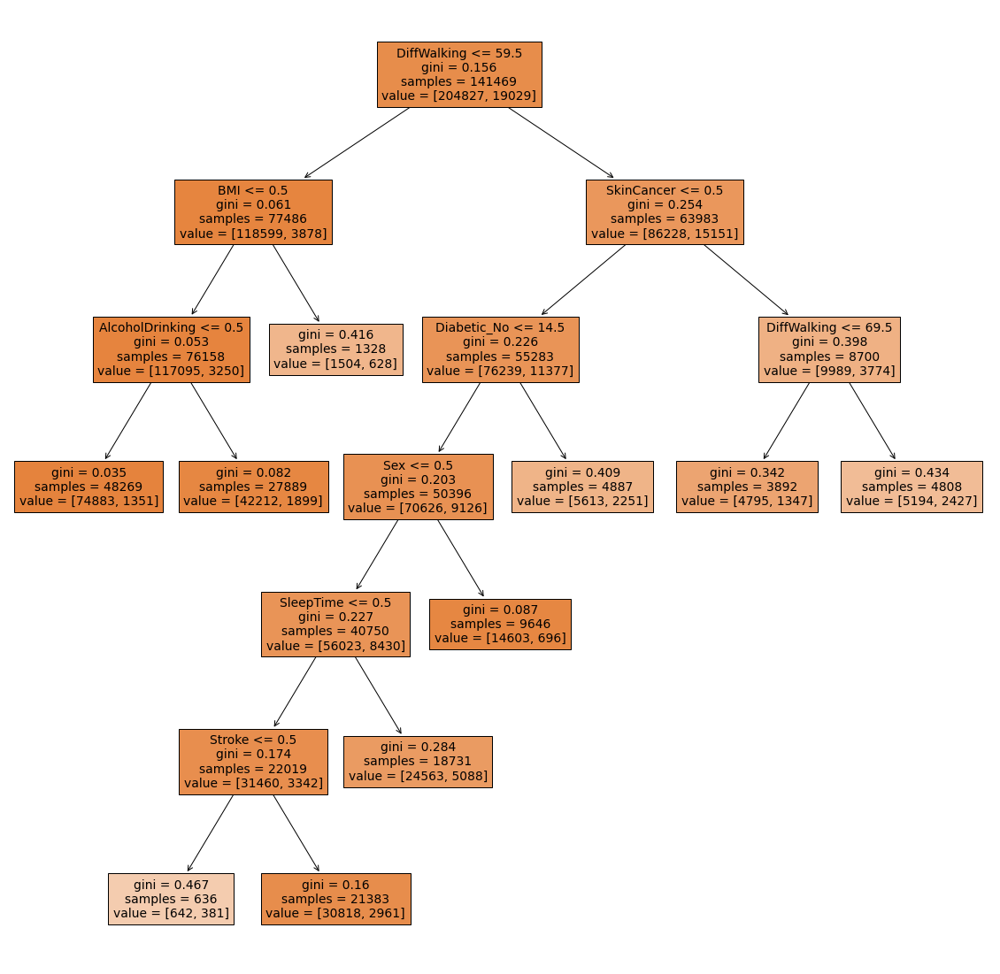

In [ ]:
plt.figure(figsize=(20,20))
_ = tree.plot_tree(model.estimators_[0], feature_names=features1, filled=True)

In [ ]:
features1 = ['AgeCategory', 'BMI', 'DiffWalking',
       'MentalHealth', 'PhysicalHealth', 'SleepTime', 'Smoking']

In [ ]:
importances = model.feature_importances_
std = np.std([tree.feature_importances_ for tree in model.estimators_], axis=0)
forest_importances = pd.Series(importances, index=features1)

figImportance = px.bar(forest_importances, title="Feature Significance", 
                     template="plotly_white", height=800).update_xaxes(categoryorder="total descending")


figImportance.show()

ValueError: ignored

In [ ]:
scaled = StandardScaler() 
scaled.fit(df_num3) 
scaled_data = scaled.transform(df_num3) 

#Run Principal Component Analysis
from sklearn.decomposition import PCA 
pca = PCA(n_components=3) 
pca.fit(scaled_data) 
xpca = pca.transform(scaled_data)

PC1_label = "PC1 {}%".format(round(pca.explained_variance_ratio_[0],2)*100)
PC2_label = "PC2 {}%".format(round(pca.explained_variance_ratio_[1],2)*100) 
PC3_label = "PC3 {}%".format(round(pca.explained_variance_ratio_[2],2)*100)

#create dataframe for PCA
df_pca = pd.DataFrame(xpca)
df_pca.columns = [PC1_label,PC2_label,PC3_label]
df_pca

figPCA = px.scatter_3d(df_pca, x=PC1_label, y=PC2_label, z=PC3_label, 
                       title="PCA 3D plot", color=df_num3.MentalHealth, 
                       template="plotly_white", height=800)
figPCA.show()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:985: RuntimeWarning:

invalid value encountered in true_divide

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:990: RuntimeWarning:

invalid value encountered in true_divide

/usr/local/lib/python3.7/dist-packages/sklearn/utils/extmath.py:1020: RuntimeWarning:

invalid value encountered in true_divide



ValueError: ignored

In [ ]:
figPCA = px.scatter(df_pca, x=PC1_label, y=PC2_label,
                       title="PCA plot", color=df_num3.MentalHealth, 
                       template="plotly_white", height=800)
figPCA.show()

In [ ]:
df_pca2 = pd.DataFrame(columns = ['HeartDisease','AgeCategory', 'BMI', 'DiffWalking',
       'MentalHealth', 'PhysicalHealth', 'SleepTime', 'Smoking'])

df_pca2['PC1'] = df_pca.iloc[:,0]
df_pca2['PC2'] = df_pca.iloc[:,1]
df_pca2['cluster'] = kmeans_m.labels_
df_pca2['AgeCategory'] = df_num3['AgeCategory']
df_pca2['HeartDisease'] = df_num3['HeartDisease']
df_pca2['BMI'] = df_num3['BMI']
df_pca2['DiffWalking'] = df_num3['DiffWalking']
df_pca2['MentalHealth'] = df_num3['MentalHealth']
df_pca2['PhysicalHealth'] = df_num3['PhysicalHealth']
df_pca2['SleepTime'] = df_num3['SleepTime']
df_pca2['Smoking'] = df_num3['Smoking']

df_pca2

In [ ]:
import plotly.express as px

fig = px.scatter(df_pca2, x="PC1", y="PC2", color="SleepTime", 
                 facet_col="HeartDisease", facet_row="cluster", 
                 width=800, height=2000)
fig.show()